In [1]:
import numpy as np
import scipy.fftpack
from PIL import Image
from PIL import ImageOps
from scipy import ndimage
from matplotlib import pyplot as plt

## Task 1.1

In [60]:
im_stripes_vert = Image.open('./input_images/stripes_vert.gif')
im_stripes_diag = Image.open('./input_images/stripes_diag.gif')
im_stripes_vert = np.array(im_stripes_vert, dtype=np.float32)
im_stripes_diag = np.array(im_stripes_diag, dtype=np.float32)

In [ ]:
import imageio
im_stripes_vert_3_dim = imageio.v2.imread('./input_images/stripes_vert.gif')
print(f"{im_stripes_vert_3_dim.shape=}")

In [68]:
im_stripes_vert = im_stripes_vert > 1.1
im_stripes_vert = im_stripes_vert[10:-10, 10:-10]
im_stripes_vert = im_stripes_vert.astype(float)

im_stripes_diag = im_stripes_diag > 1.1
im_stripes_diag = im_stripes_diag[10:-10, 10:-10]

im_stripes_diag = im_stripes_diag.astype(float)

im_stripes_vert.shape


(196, 196)

im_stripes_diag.min()=np.float64(0.0) ; im_stripes_diag.max()=np.float64(1.0)


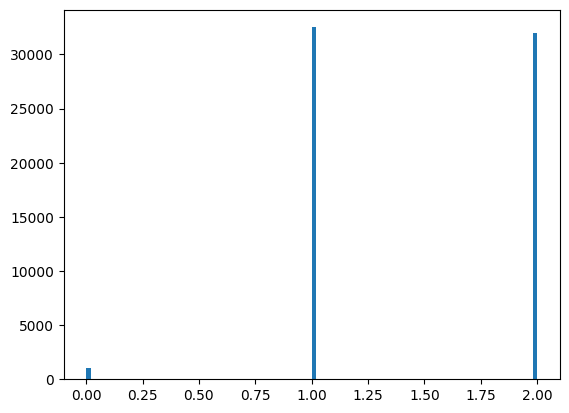

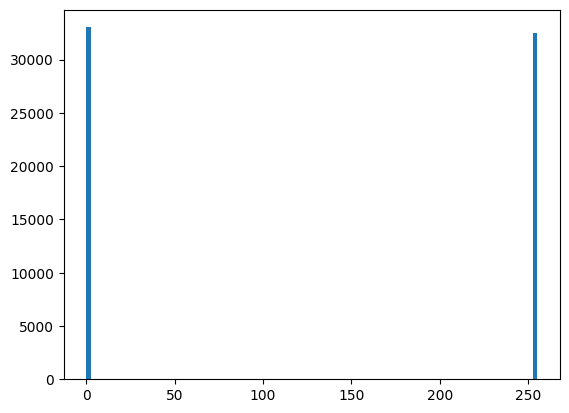

In [65]:
print(f"{im_stripes_diag.min()=} ; {im_stripes_diag.max()=}")

vert_img = Image.open('./input_images/stripes_vert.gif')
stripes_vert1 = np.array(vert_img)

plt.hist(stripes_vert1.flatten(), bins=100)
plt.show()

stripes_vert2 = np.array((vert_img).convert('L'))
plt.hist(stripes_vert2.flatten(), bins=100)
plt.show()

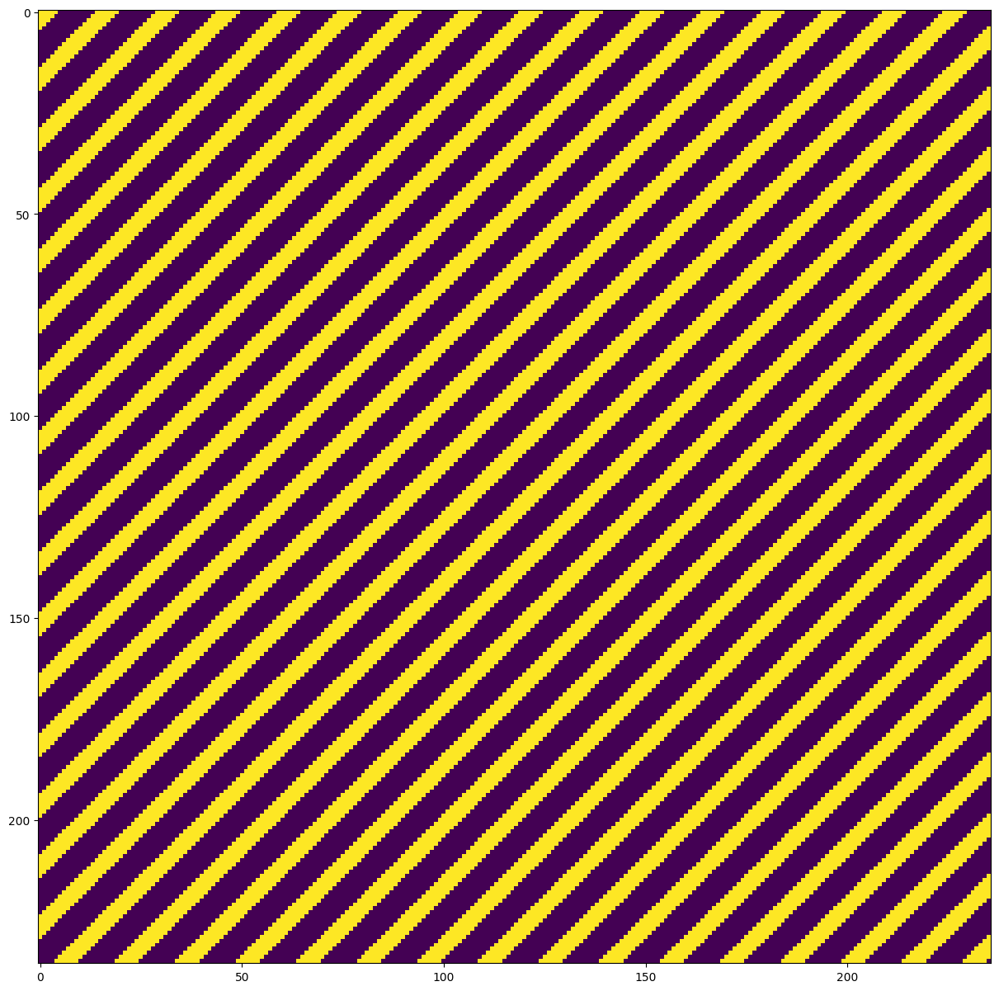

In [5]:
plt.figure(figsize=(15,15))
plt.imshow(im_stripes_diag)
plt.show()

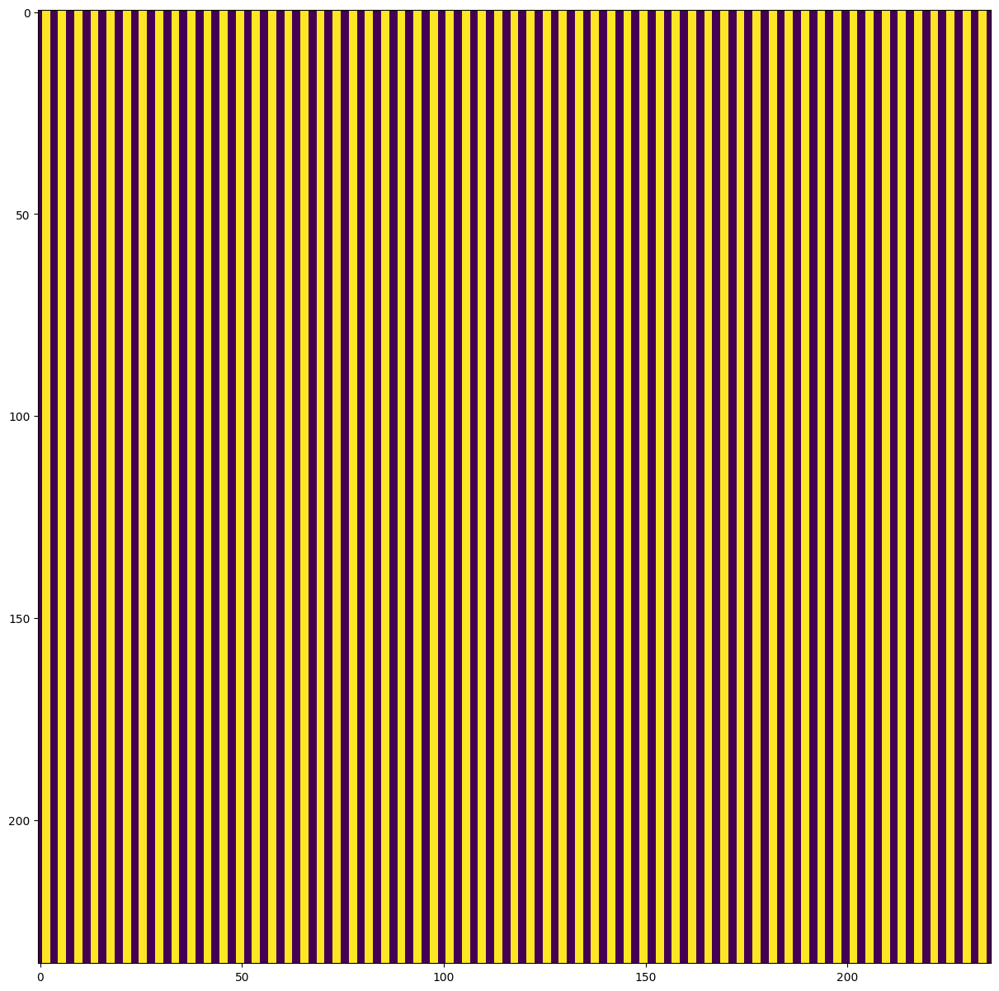

In [6]:
plt.figure(figsize=(15,15))
plt.imshow(im_stripes_vert)
plt.show()

## Task 1.2

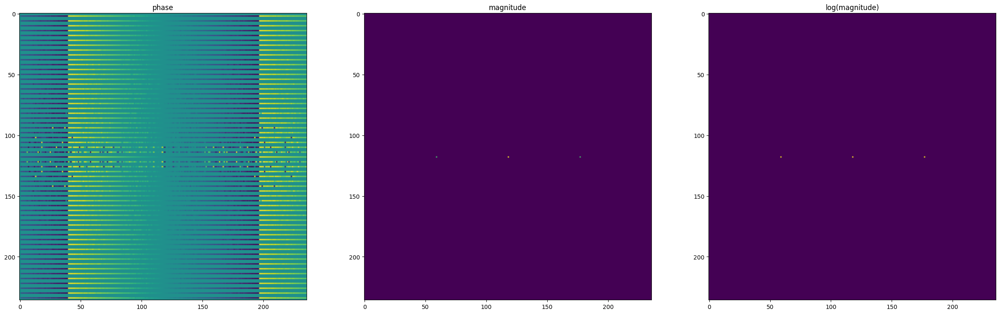

In [ ]:
im_fft = np.fft.fftshift(scipy.fftpack.fft2(im_stripes_vert))
fig, ax = plt.subplots(1, 3, figsize=(30, 10))

ax[0].set_title("phase")
ax[0].imshow(np.angle(im_fft))
ax[1].set_title("magnitude")
ax[1].imshow(np.abs(im_fft))

ax[2].set_title("log(magnitude)")
ax[2].imshow(np.log(np.abs(im_fft)+1e-4))

plt.show()

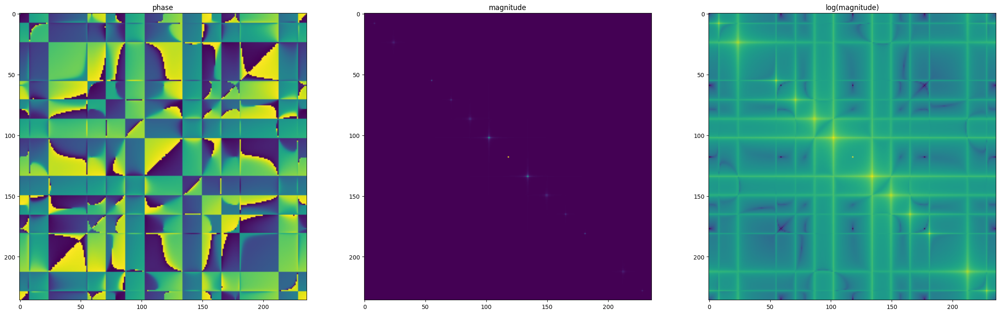

In [ ]:
im_fft = np.fft.fftshift(scipy.fftpack.fft2(im_stripes_diag))
fig, ax = plt.subplots(1, 3, figsize=(30, 10))

ax[0].set_title("phase")
ax[0].imshow(np.angle(im_fft))
ax[1].set_title("magnitude")
ax[1].imshow(np.abs(im_fft))

ax[2].set_title("log(magnitude)")
ax[2].imshow(np.log(np.abs(im_fft)+1e-4))

plt.show()

## Task 1.3

In [ ]:
im_saturn = Image.open('./input_images/saturn.png')

im_saturn = np.array(im_saturn, dtype=np.float32)
def rgb2gray(rgb):
    return np.dot(rgb[...,:3], [0.2989, 0.5870, 0.1140])

im_saturn = rgb2gray(im_saturn)

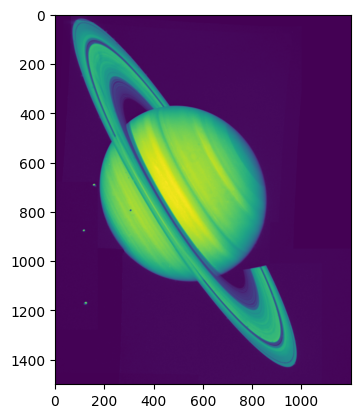

In [11]:
plt.imshow(im_saturn)
plt.show()

## Task 1.4

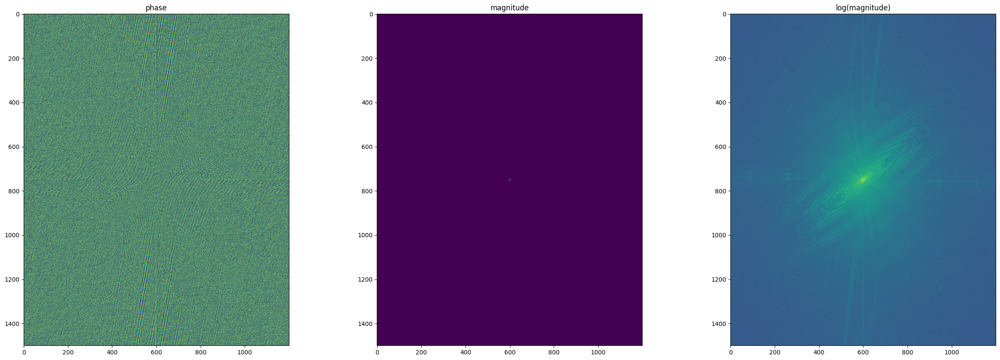

In [12]:
im_fft = np.fft.fftshift(scipy.fftpack.fft2(im_saturn))
fig, ax = plt.subplots(1, 3, figsize=(30, 10))

ax[0].set_title("phase")
ax[0].imshow(np.angle(im_fft))
ax[1].set_title("magnitude")
ax[1].imshow(np.abs(im_fft))

ax[2].set_title("log(magnitude)")


ax[2].imshow(np.log(np.abs(im_fft)+1.))

plt.show()

## Task 1.5

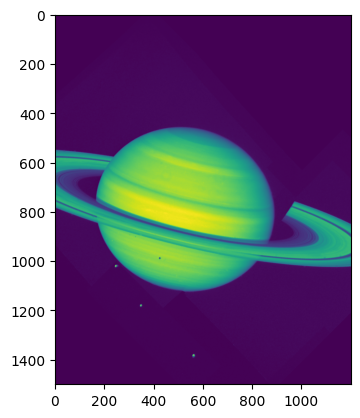

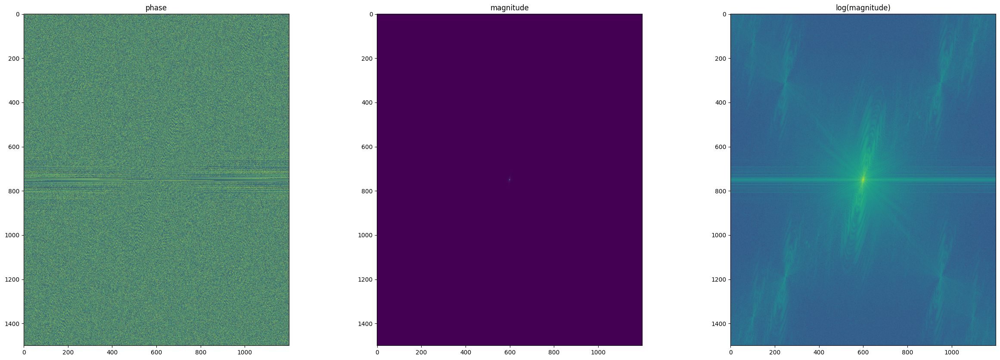

In [13]:
# Rotation

im_saturn_ = Image.fromarray(im_saturn.astype(np.uint8))

im_saturn_ = np.array(im_saturn_.rotate(45), dtype=np.float32)

plt.imshow(im_saturn_)
plt.show()

im_fft = np.fft.fftshift(scipy.fftpack.fft2(im_saturn_))
fig, ax = plt.subplots(1, 3, figsize=(30, 10))

ax[0].set_title("phase")
ax[0].imshow(np.angle(im_fft))
ax[1].set_title("magnitude")
ax[1].imshow(np.abs(im_fft))

ax[2].set_title("log(magnitude)")


ax[2].imshow(np.log(np.abs(im_fft)+1.))

plt.show()

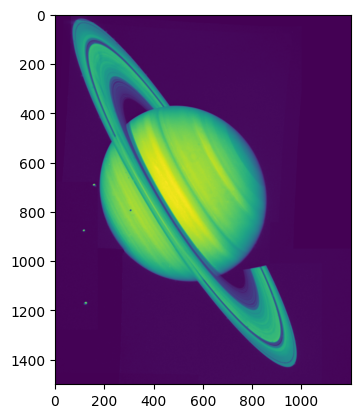

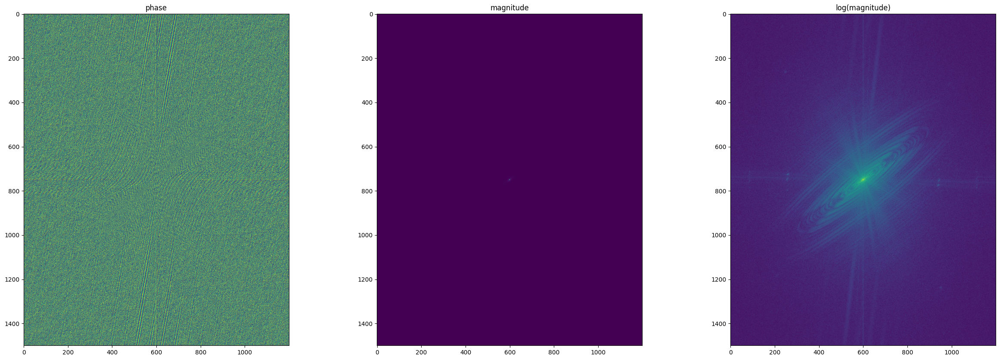

In [ ]:
# Change contrast
im_saturn_ = ((im_saturn - im_saturn.min()) / (im_saturn.max()-im_saturn.min()))
plt.imshow(im_saturn_)
plt.show()

im_fft = np.fft.fftshift(scipy.fftpack.fft2(im_saturn_))
fig, ax = plt.subplots(1, 3, figsize=(30, 10))

ax[0].set_title("phase")
ax[0].imshow(np.angle(im_fft))
ax[1].set_title("magnitude")
ax[1].imshow(np.abs(im_fft))

ax[2].set_title("log(magnitude)")


ax[2].imshow(np.log(np.abs(im_fft)+1.))

plt.show()

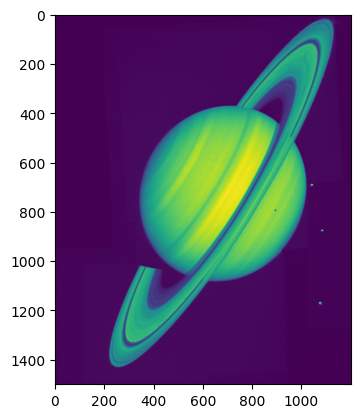

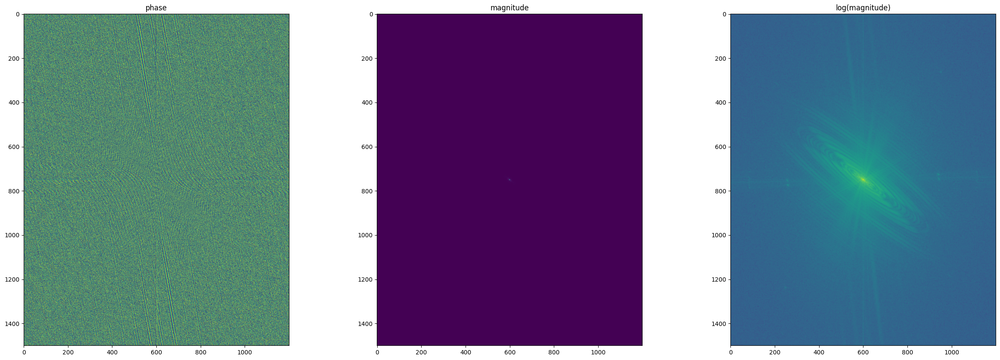

In [ ]:
# Horizontal flip

im_saturn_ = Image.fromarray(im_saturn.astype(np.uint8))

im_saturn_ = np.array(ImageOps.mirror(im_saturn_), dtype=np.float32)



plt.imshow(im_saturn_)
plt.show()

im_fft_ = np.fft.fftshift(scipy.fftpack.fft2(im_saturn_))
fig, ax = plt.subplots(1, 3, figsize=(30, 10))

ax[0].set_title("phase")
ax[0].imshow(np.angle(im_fft_))
ax[1].set_title("magnitude")
ax[1].imshow(np.abs(im_fft_))

ax[2].set_title("log(magnitude)")


ax[2].imshow(np.log(np.abs(im_fft_)+1.))

plt.show()


## Task 1.6+1.7

In [16]:
im_fft = np.fft.fftshift(scipy.fftpack.fft2(im_saturn))

In [17]:
im_fft_cropped = np.array(im_fft)
im_fft_cropped[:600] = 0.
im_fft_cropped[900:] = 0.
im_fft_cropped[:,:400] = 0.
im_fft_cropped[:,700:] = 0.


im_fft_cropped[:700] = 0.
im_fft_cropped[800:] = 0.
im_fft_cropped[:,:500] = 0.
im_fft_cropped[:,650:] = 0.

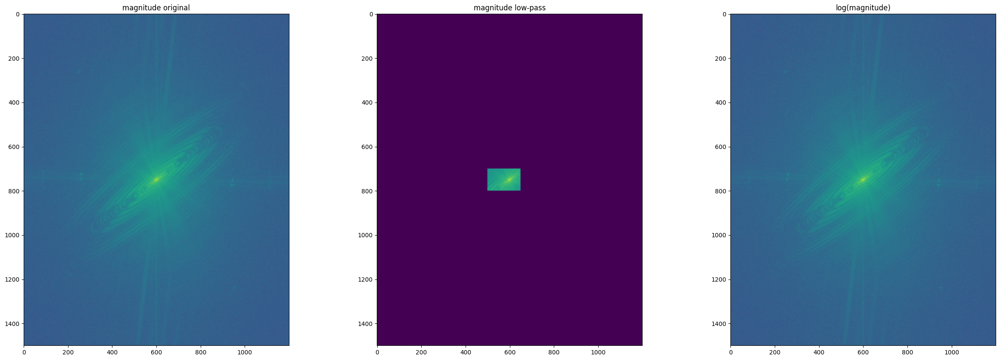

In [18]:
fig, ax = plt.subplots(1, 3, figsize=(30, 10))

ax[0].set_title("magnitude original")
ax[0].imshow(np.log(np.abs(im_fft)+1))
ax[1].set_title("magnitude low-pass")
ax[1].imshow(np.log(np.abs(im_fft_cropped)+1))

ax[2].set_title("log(magnitude)")


ax[2].imshow(np.log(np.abs(im_fft)+1.))

plt.show()

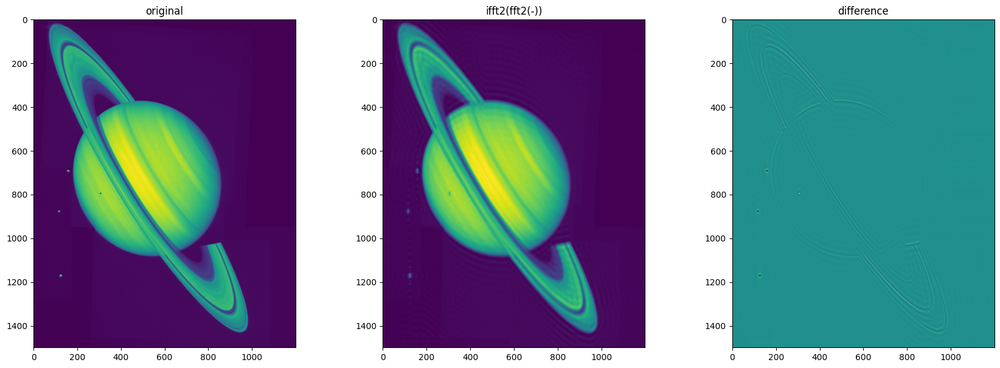

In [67]:
im_saturn_rec = np.abs(scipy.fftpack.ifft2(im_fft_cropped))

fig, ax = plt.subplots(1, 3, figsize=(21, 7))

ax[0].set_title("original")
ax[0].imshow(im_saturn)

ax[1].imshow(im_saturn_rec)
ax[1].set_title("ifft2(fft2(-))")

ax[2].imshow(im_saturn_rec-im_saturn)
ax[2].set_title("difference")
plt.show()

## Task 1.8


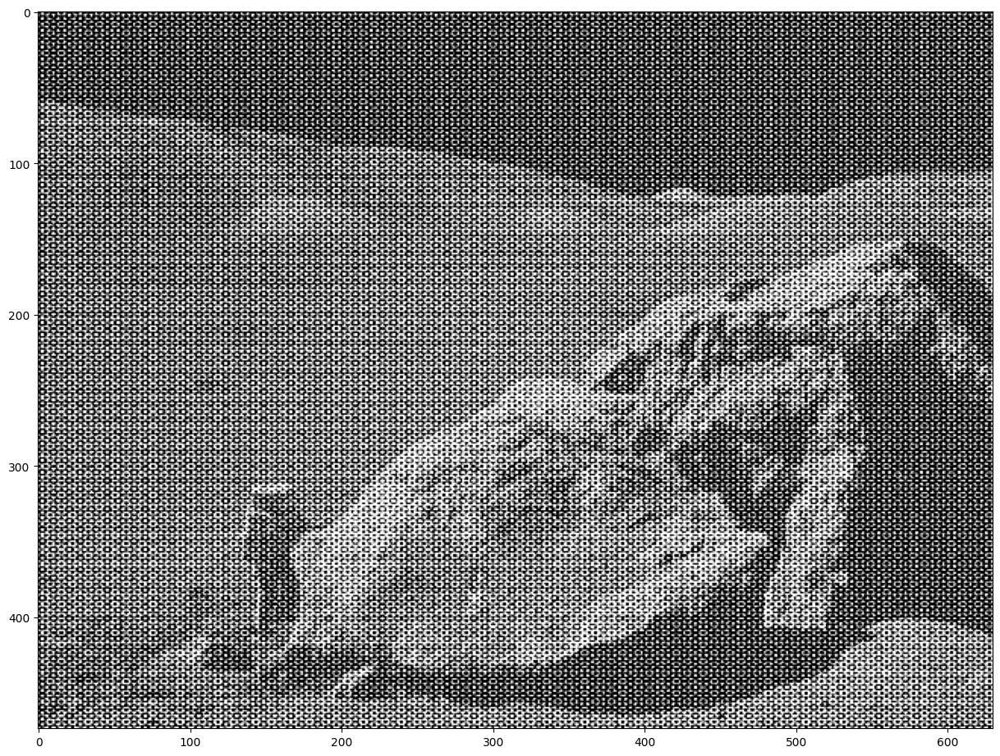

In [ ]:
im_moon = Image.open('./input_images/moonlanding.png')
im_moon = np.array(im_moon, dtype=np.float32)
plt.figure(figsize=(15, 15))
plt.imshow(im_moon, cmap='gray')
plt.show()

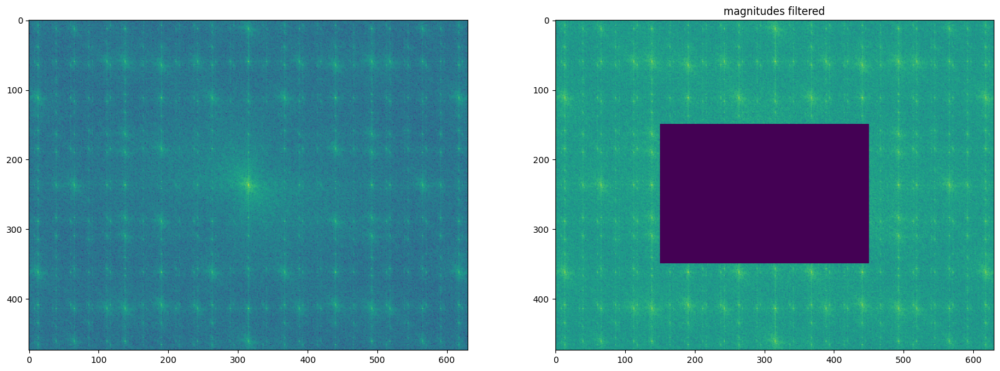

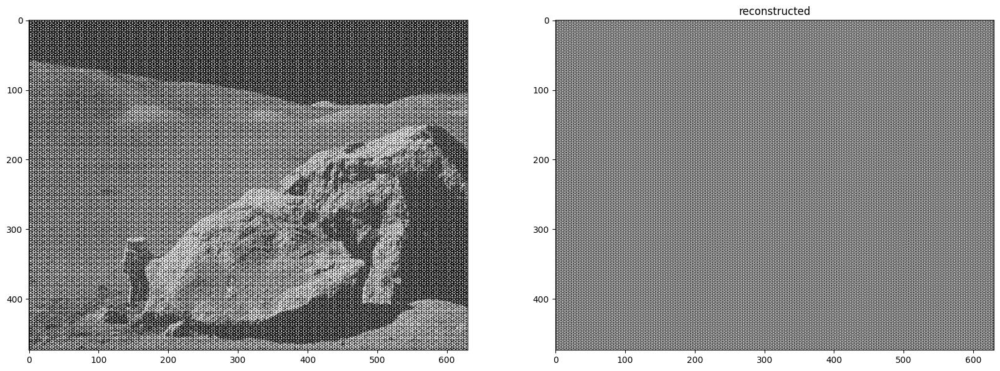

In [23]:
im_fft = np.fft.fftshift(scipy.fftpack.fft2(im_moon))

fig, ax = plt.subplots(1, 2, figsize=(20, 10))
ax[0].imshow(np.log(np.abs(im_fft)+1.))
ax[1].set_title("magnitudes")
# High-pass filter
im_fft[150:350][:, 150:450] = 0.

ax[1].imshow(np.log(np.abs(im_fft)+1.))
ax[1].set_title("magnitudes filtered")
plt.show()


im_rec = scipy.fftpack.ifft2(np.fft.fftshift(im_fft)).real

fig, ax = plt.subplots(1, 2, figsize=(20, 10))
ax[0].imshow(im_moon, cmap='gray')
ax[1].set_title("original")
ax[1].imshow(im_rec, cmap='gray')
ax[1].set_title("reconstructed")
plt.show()

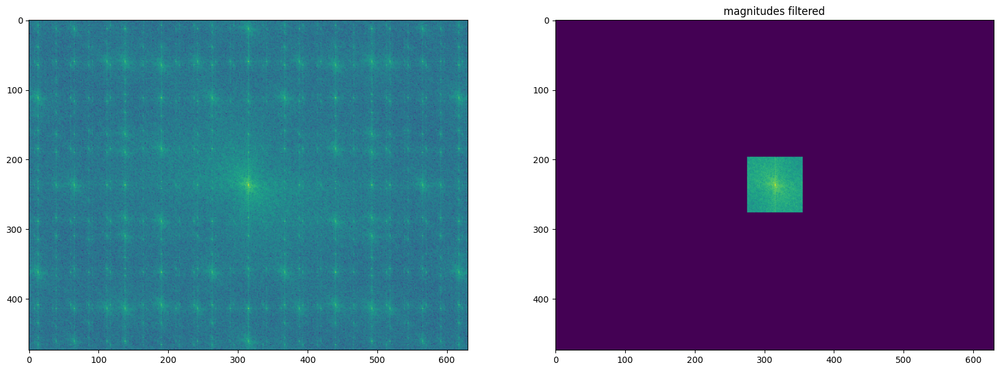

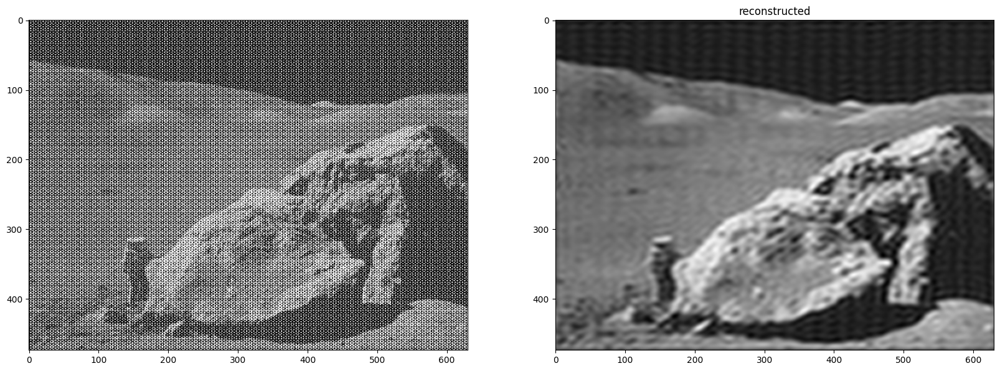

In [71]:
# Now apply low-pass filtering
im_fft = np.fft.fftshift(scipy.fftpack.fft2(im_moon))

low_pass_mask = np.zeros_like(im_fft)
h,w = im_fft.shape
hh, ww = 40, 40
low_pass_mask[h // 2 - hh:h // 2 + hh][:, w//2 - ww :w//2 +ww ] = 1.

t = np.abs(im_fft) < np.percentile(np.abs(im_fft), 95)

fig, ax = plt.subplots(1, 2, figsize=(20, 10))
ax[0].imshow(np.log(np.abs(im_fft)+1.))
ax[1].set_title("magnitudes")

ax[1].imshow(np.log(np.abs(im_fft*low_pass_mask)+1.))
ax[1].set_title("magnitudes filtered")
plt.show()

im_rec = scipy.fftpack.ifft2(np.fft.fftshift(im_fft*low_pass_mask)).real

fig, ax = plt.subplots(1, 2, figsize=(20, 10))
ax[0].imshow(im_moon, cmap='gray')
ax[1].set_title("original")
ax[1].imshow(im_rec, cmap='gray')
ax[1].set_title("reconstructed")
plt.show()

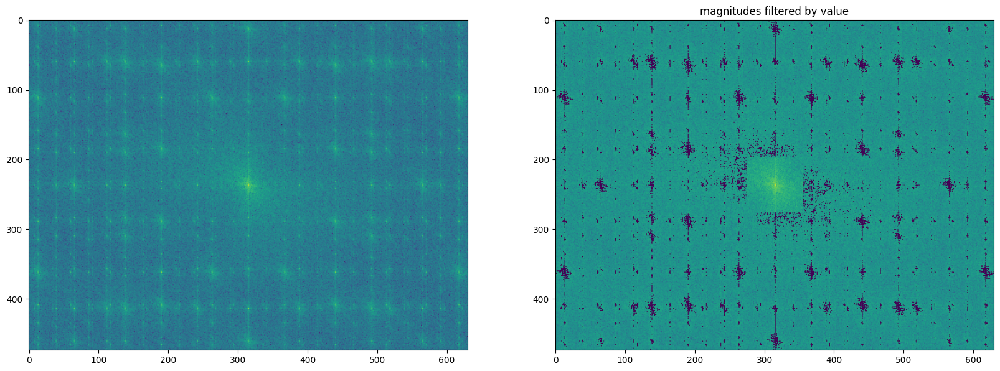

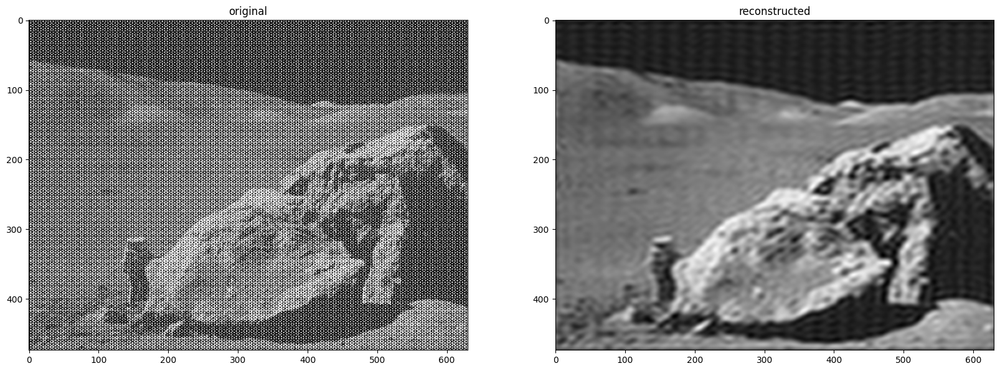

In [70]:
# This is not what we wanted you to do!
# This is what happens when thresholding by values
im_fft = np.fft.fftshift(scipy.fftpack.fft2(im_moon))

low_pass_mask = np.zeros_like(np.abs(im_fft))
h,w = im_fft.shape
hh, ww = 40, 40
low_pass_mask[h // 2 - hh:h // 2 + hh][:, w//2 - ww :w//2 +ww ] = 1.

t = np.abs(im_fft) < np.percentile(np.abs(im_fft), 95)

mask = np.maximum(low_pass_mask, t)

fig, ax = plt.subplots(1, 2, figsize=(20, 10))
ax[0].imshow(np.log(np.abs(im_fft)+1.))
ax[1].set_title("magnitudes")

ax[1].imshow(np.log(np.abs(im_fft*mask)+1.))
ax[1].set_title("magnitudes filtered by value")
plt.show()

im_rec_mag_threshold = scipy.fftpack.ifft2(np.fft.fftshift(im_fft*mask)).real

fig, ax = plt.subplots(1, 2, figsize=(20, 10))
ax[0].imshow(im_moon, cmap='gray')
ax[0].set_title("original")
ax[1].imshow(im_rec, cmap='gray')
ax[1].set_title("reconstructed")
plt.show()

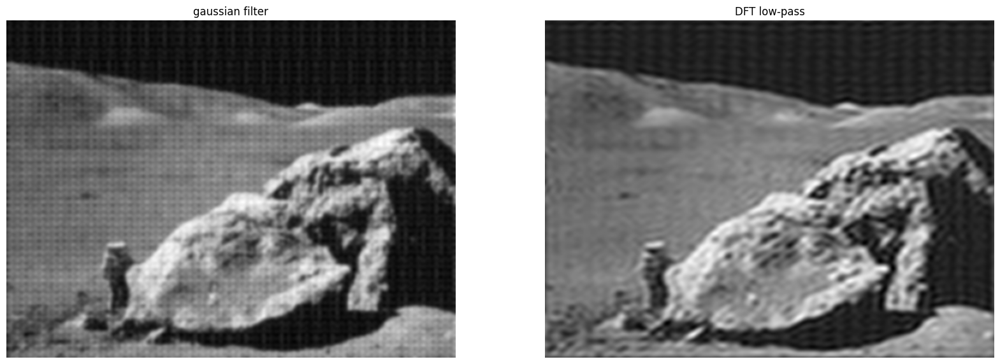

In [72]:
im_rec_gaussian = ndimage.gaussian_filter(im_moon, 2.5)

fig, ax = plt.subplots(1, 2, figsize=(20, 20))
ax[0].imshow(im_rec_gaussian, cmap='gray')
ax[0].set_title("gaussian filter")
ax[0].axis("off")
ax[1].imshow(im_rec, cmap='gray')
ax[1].set_title("DFT low-pass")
ax[1].axis("off")

plt.show()

# Task 2

## Task 2.1 + 2.2

In [39]:
# helper functions
def showImage(img,size=(8,8)):
    plt.figure(figsize=size)
    plt.imshow(img,cmap='gray')
    plt.xticks([]),plt.yticks([])
    plt.show()

In [37]:
img = Image.open("input_images/alias_sample.png").convert('L')

width, height = img.size
array = np.asarray(img)
print(array.shape)

(342, 342)


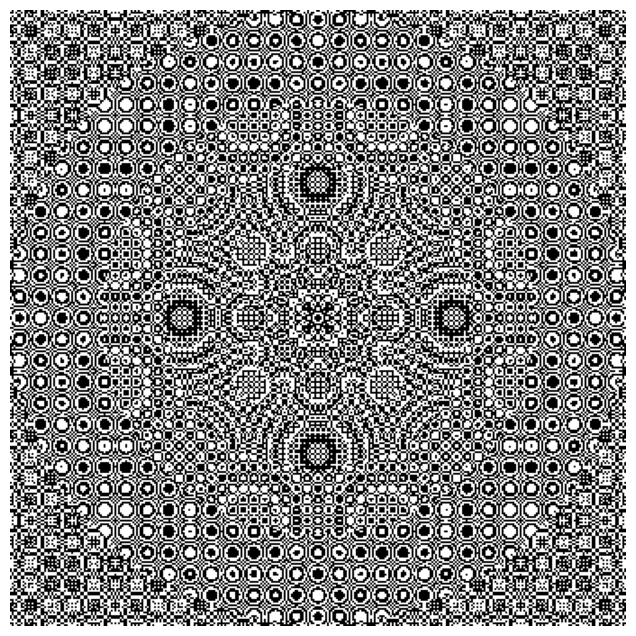

In [38]:
plt.figure(figsize=(8,8))
plt.axis("off")
plt.imshow(img, cmap='gray')
plt.show()

## Task 2.3

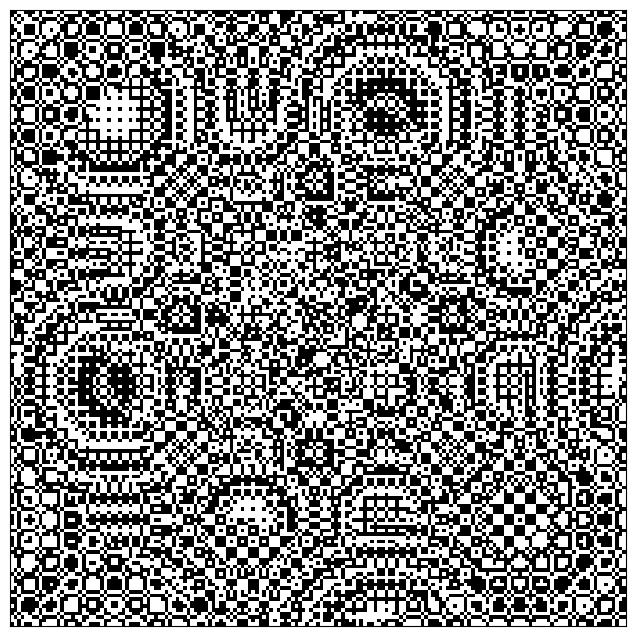

In [40]:
DOWN_SAMPLE_RATIO = 2

width, height = img.size
img_NEAREST = img.resize((int(width/DOWN_SAMPLE_RATIO), int(height/DOWN_SAMPLE_RATIO)),resample=Image.NEAREST)
showImage(img_NEAREST)

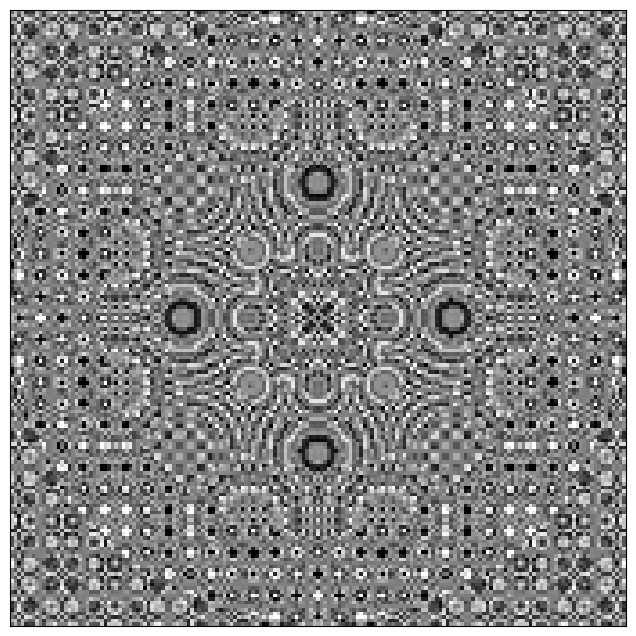

In [42]:
img_LANCZOS = img.resize((int(width/DOWN_SAMPLE_RATIO), int(height/DOWN_SAMPLE_RATIO)), resample=Image.LANCZOS)
showImage(img_LANCZOS)

## 2.4 Low pass filter with Gaussian

In [43]:
def gaussian_filter(size: int, var: float) -> np.ndarray:
    # if size is not odd number, the resulting kernel shifts the image
    grid_range = np.linspace(-np.floor((size-1)/2), np.ceil((size-1)/2), size)
    x, y = np.meshgrid(grid_range, grid_range)
    kernel = 1./(2*np.pi*var) * np.exp(-1./(2*var)*(np.square(x)+np.square(y)))
    
    # normalize the filter
    return kernel / np.sum(kernel)

def conv2d(x, kernel):
    """
    Performs a 2D convolution operation with a single kernel.

    Args:
        x      (array): the input array of shape (H, W, 1).
        kernel (array): the kernel that is convolved over the input.

    Returns:
        out    (array): the output array.
    """
    assert kernel.shape[0] == kernel.shape[1]

    x_height = x.shape[0]
    x_width = x.shape[1]
   
    f_size = kernel.shape[0]
    out_height = int(x_height - f_size + 1)
    out_width = int(x_width - f_size + 1)
    out = np.zeros((out_height, out_width, 1))

    w = 0
    h = 0
    for h in range(out_height):
        for w in range(out_width):
            out[h, w] = np.sum(x[h:h + f_size, w:w + f_size] * kernel)

    return out

def normalization(x): return (x - np.min(x)) / (np.max(x) - np.min(x))

In [44]:
# add new axis
img_array = np.array(img)[..., None]
print(img_array.shape)

(342, 342, 1)


In [45]:
# apply gaussian
w = gaussian_filter(size=10, var=5)
array_filtered = normalization(conv2d(img_array, kernel=w)).squeeze()

### 2.5 Convert back to PIL and resize with NEAREST then plot

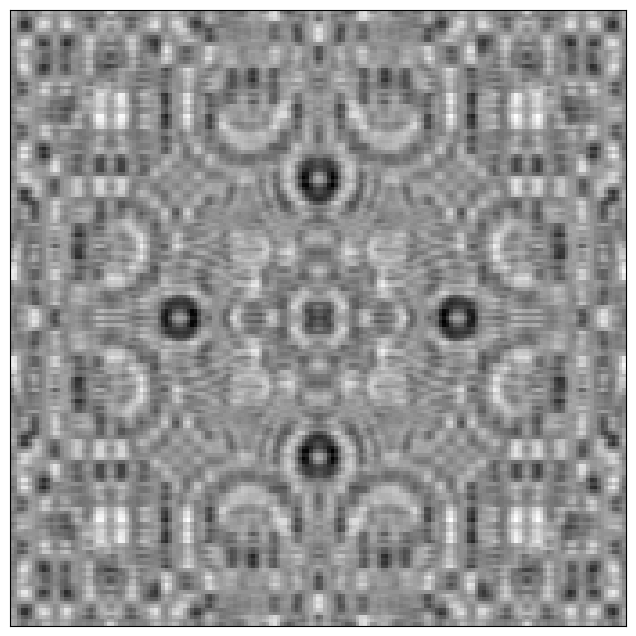

In [48]:
img_gaussian = Image.fromarray(np.uint8(array_filtered*255))
img_gaussian_resize = img_gaussian.resize((int(width/DOWN_SAMPLE_RATIO), int(height/DOWN_SAMPLE_RATIO)),resample=Image.NEAREST)
showImage(img_gaussian_resize)

### 2.6 Low Pass Filtering in frequency domain

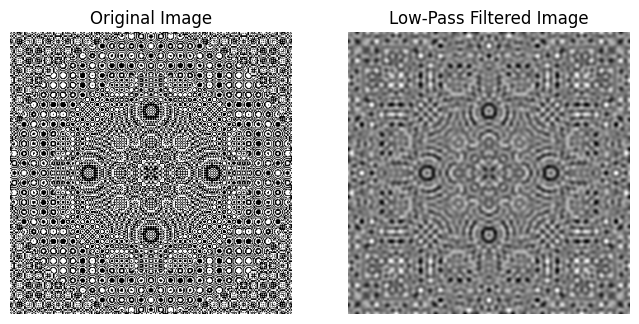

In [ ]:
# You can again mask everything except a rectangle in the center. We instead show here how to mask everything except a circle in the center.

from scipy import fftpack

# Compute the FFT of the image
fft = fftpack.fft2(array)

# Shift the zero-frequency component to the center of the spectrum
fft_shifted = fftpack.fftshift(fft)

# Define the size of the filter
size = 50

# Create a 2D grid of pixel coordinates with the same shape as the image
y, x = np.meshgrid(np.arange(array.shape[0]), np.arange(array.shape[1]))

# Compute the distance of each pixel from the center of the image
dist = np.sqrt((x - array.shape[1] // 2) ** 2 + (y - array.shape[0] // 2) ** 2)

# Create a circular low-pass filter with the same size as the image
low_pass = np.zeros_like(array)
low_pass[dist < size] = 1

# Apply the filter to the shifted FFT
fft_filtered = fft_shifted * low_pass

# Shift the zero-frequency component back to the corners of the spectrum
fft_filtered_shifted = fftpack.ifftshift(fft_filtered)

# Compute the inverse FFT of the filtered spectrum
image_fft = np.real(fftpack.ifft2(fft_filtered_shifted))

# Display the original and filtered images
plt.figure(figsize=(8, 4))
plt.subplot(121)
plt.imshow(img, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.subplot(122)
plt.imshow(image_fft, cmap='gray')
plt.title('Low-Pass Filtered Image')
plt.axis('off')
plt.show()

(171, 171)


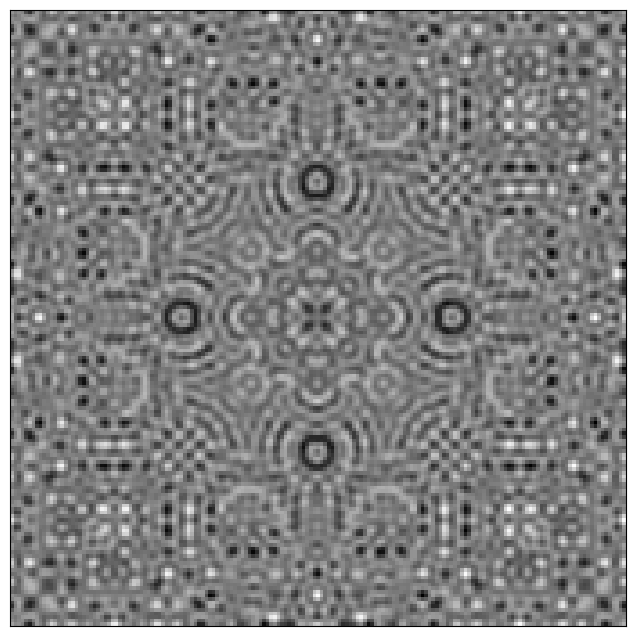

In [52]:
image_fft_resize= Image.fromarray(np.uint8(normalization(np.squeeze(image_fft))*255)).resize((int(width/DOWN_SAMPLE_RATIO), int(height/DOWN_SAMPLE_RATIO)),resample=Image.NEAREST)
showImage(image_fft_resize)

### 2.7 Plot them and compare and provide explanation

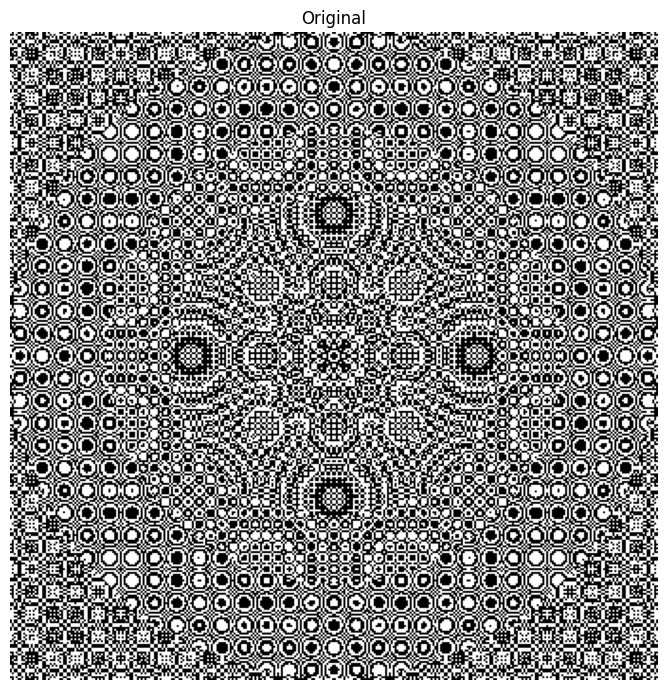

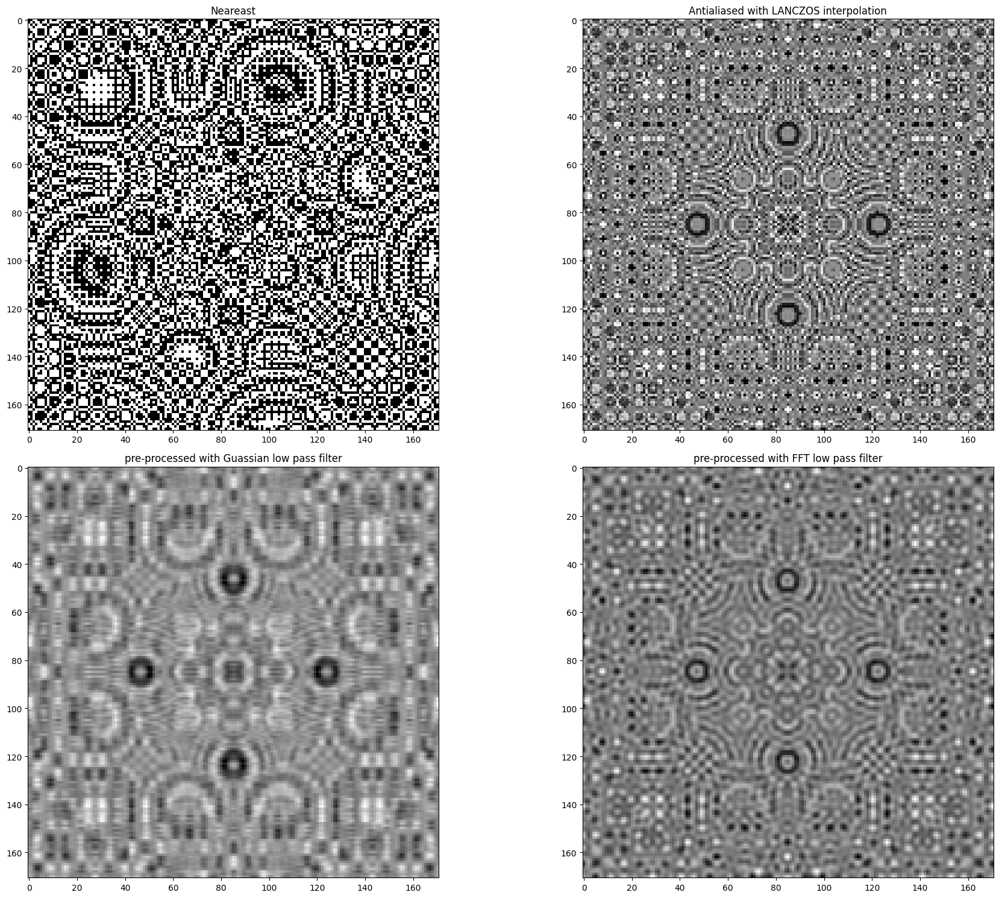

In [53]:
plt.figure(figsize=(10, 7))
plt.imshow(img,cmap="gray")
plt.title("Original")
plt.axis("off")
plt.tight_layout()
plt.show()


# fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(40, 30)) 
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 15))
# ax1.imshow(geralt,cmap="gray")
ax1.imshow(img_NEAREST, cmap="gray")
ax1.set_title("Neareast")
ax2.imshow(img_LANCZOS, cmap="gray")
ax2.set_title("Antialiased with LANCZOS interpolation")

ax3.imshow(img_gaussian_resize,cmap="gray")
ax3.set_title("pre-processed with Guassian low pass filter")

ax4.imshow(image_fft_resize,cmap="gray")
ax4.set_title("pre-processed with FFT low pass filter")
plt.tight_layout()
plt.show()

Both Fourier low-pass filters and Gaussian filters can be used for low-frequency passing in image processing. However, they are based on different mathematical principles and have different characteristics.

Fourier low-pass filters operate in the frequency domain by suppressing high-frequency components of the Fourier transform of an image. These filters are typically implemented by multiplying the Fourier transform of an image with a low-pass filter mask that has a circular shape. The cutoff frequency of the filter determines the maximum spatial frequency that is allowed to pass through the filter. The advantage of Fourier low-pass filters is that they are fast and efficient to compute in the frequency domain. However, they can produce ringing artifacts in the spatial domain, which are caused by the Gibbs phenomenon, and they are sensitive to image boundary effects.

On the other hand, Gaussian filters operate in the spatial domain by convolving an image with a Gaussian kernel that has a bell-shaped curve. The standard deviation of the Gaussian kernel determines the amount of smoothing or blurring of the image. The advantage of Gaussian filters is that they are computationally simple and do not produce ringing artifacts. They are also less sensitive to image boundary effects than Fourier filters. However, Gaussian filters can cause loss of image details if the standard deviation is too high, and they are not as effective as Fourier filters in suppressing high-frequency noise.

In summary, Fourier low-pass filters and Gaussian filters are two different approaches for low-frequency passing in image processing. Fourier filters are based on suppressing high-frequency components in the frequency domain, while Gaussian filters are based on smoothing an image with a Gaussian kernel in the spatial domain. The choice between these filters depends on the specific requirements of the application and the trade-offs between computational complexity, image quality, and noise suppression.